In [ ]:
# !pip install scikit-image
# !pip install diffuser

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from diffusers import DiffusionPipeline, DPMSolverMultistepScheduler
import torch

repo_id = "stabilityai/stable-diffusion-2-base"
pipe = DiffusionPipeline.from_pretrained(repo_id, torch_dtype=torch.float16, revision="fp16")

pipe.scheduler = DPMSolverMultistepScheduler.from_config(pipe.scheduler.config)
pipe = pipe.to("cuda")


/n/home12/binxuwang/.conda/envs/torch/lib/python3.10/site-packages/diffusers/pipelines/pipeline_utils.py:269: FutureWarning: You are loading the variant fp16 from stabilityai/stable-diffusion-2-base via `revision='fp16'` even though you can load it via `variant=`fp16`. Loading model variants via `revision='fp16'` is deprecated and will be removed in diffusers v1. Please use `variant='fp16'` instead.
  warnings.warn(
text_encoder/model.safetensors not found


Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

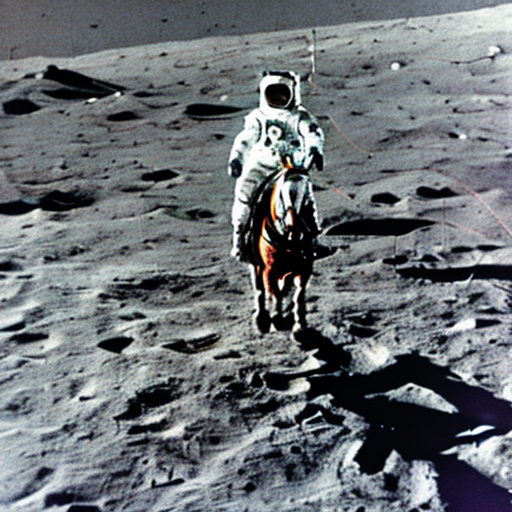

In [3]:
prompt = "High quality photo of an astronaut riding a horse on the moon."
image = pipe(prompt, num_inference_steps=25).images[0]
image

  0%|          | 0/40 [00:00<?, ?it/s]

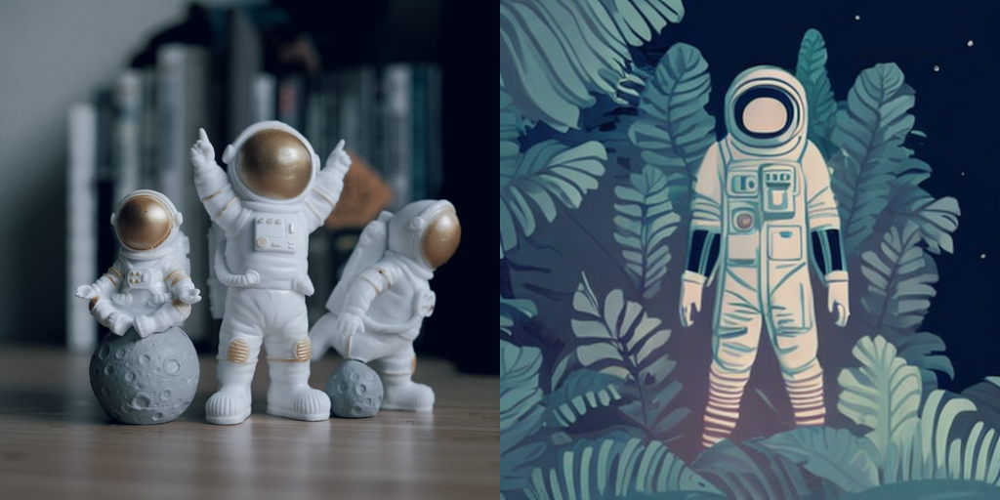

In [ ]:

# prepare image
url = "https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/img2img-init.png"
init_image = load_image(url)

prompt = "Astronaut in a jungle, cold color palette, muted colors, detailed, 8k"

# pass prompt and image to pipeline
image = pipeline(prompt, image=init_image).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

## Image editting Demos

### Image2Image

  0%|          | 0/25 [00:00<?, ?it/s]

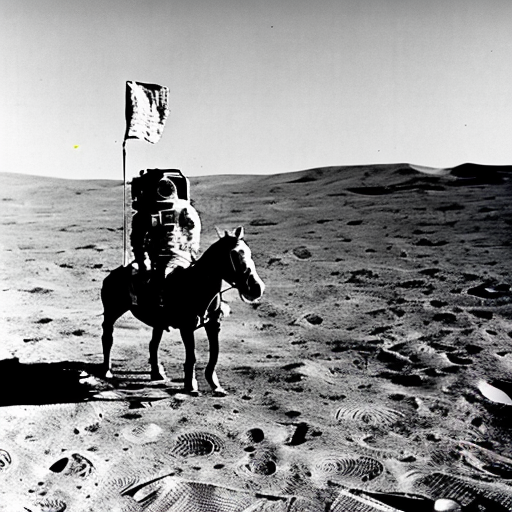

In [4]:
prompt = "High quality photo of an astronaut riding a horse on the moon."
orig_image = pipe(prompt, num_inference_steps=25).images[0]
orig_image

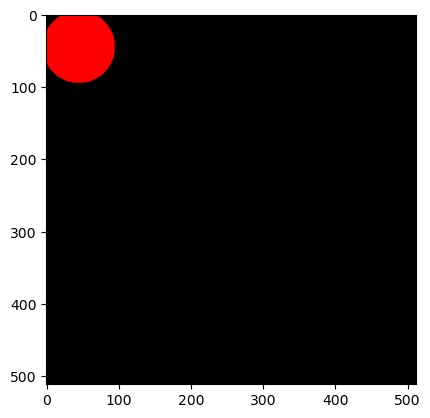

In [5]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Create a blank image
circ_img = np.zeros((512, 512, 3), dtype=np.uint8)

# Define the center and radius of the circle
center = (45, 45)
radius = 50

# Draw the filled circle on the image
cv2.circle(circ_img, center, radius, (255, 0, 0), thickness=cv2.FILLED, )

plt.imshow(circ_img)
plt.show()


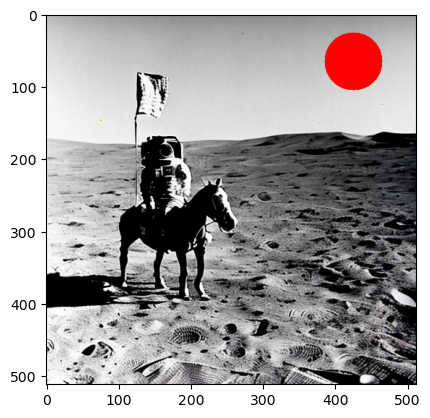

In [23]:
from PIL import Image
orig_image_edit = orig_image.copy()
orig_image_edit_arr = np.array(orig_image_edit)
center = (425, 65)
radius = 40
cv2.circle(orig_image_edit_arr, center, radius, (255, 0, 0), thickness=cv2.FILLED, )
plt.imshow(orig_image_edit_arr)
plt.show()
orig_image_edit = Image.fromarray(orig_image_edit_arr)

In [8]:
import torch
from diffusers import AutoPipelineForImage2Image, StableDiffusionImg2ImgPipeline
from diffusers.utils import make_image_grid, load_image

pipeline = AutoPipelineForImage2Image.from_pretrained("stabilityai/stable-diffusion-2-base",
     torch_dtype=torch.float16, variant="fp16", use_safetensors=True
) # "runwayml/stable-diffusion-v1-5",
pipeline.enable_model_cpu_offload()
# remove following line if xFormers is not installed or you have PyTorch 2.0 or higher installed
# pipeline.enable_xformers_memory_efficient_attention()


Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

In [39]:
import torch
from diffusers import AutoPipelineForImage2Image, StableDiffusionImg2ImgPipeline
from diffusers.utils import make_image_grid, load_image

pipeline = StableDiffusionImg2ImgPipeline.from_pretrained("stabilityai/stable-diffusion-2-base",
     torch_dtype=torch.float16, variant="fp16", use_safetensors=True
) # "runwayml/stable-diffusion-v1-5",
pipeline.enable_model_cpu_offload()

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

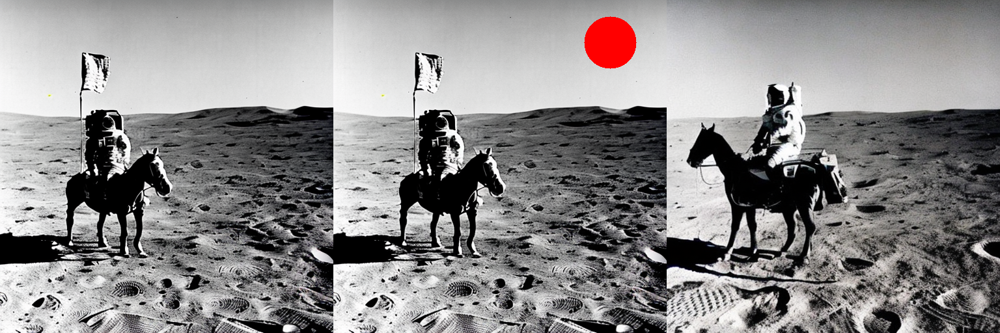

In [40]:
prompt = "High quality photo of an astronaut riding a horse on the moon."
# pass prompt and image to pipeline
image = pipeline(prompt, image=orig_image_edit).images[0]
make_image_grid([orig_image, orig_image_edit, image], rows=1, cols=3)

  0%|          | 0/10 [00:00<?, ?it/s]

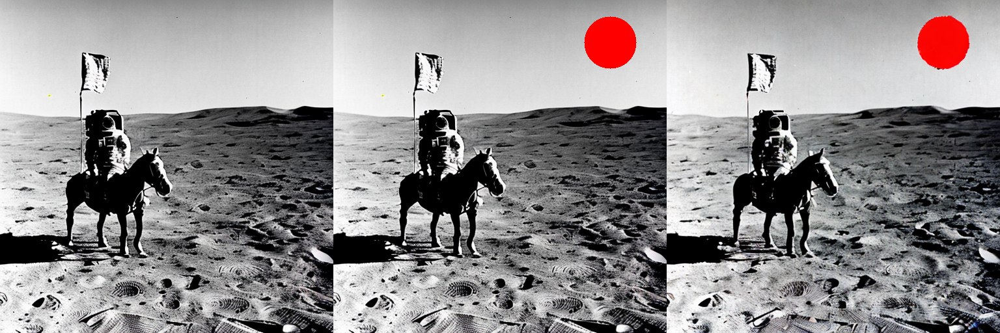

In [41]:
prompt = "High quality photo of an astronaut riding a horse on the moon."
# pass prompt and image to pipeline
image = pipeline(prompt, image=orig_image_edit, strength=0.2).images[0]
make_image_grid([orig_image, orig_image_edit, image], rows=1, cols=3)

  0%|          | 0/25 [00:00<?, ?it/s]

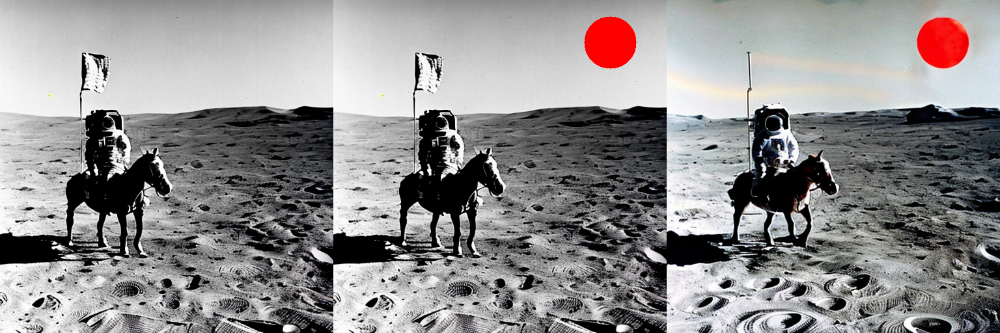

In [42]:
prompt = "High quality photo of an astronaut riding a horse on the moon."
# pass prompt and image to pipeline
image = pipeline(prompt, image=orig_image_edit, strength=0.5).images[0]
make_image_grid([orig_image, orig_image_edit, image], rows=1, cols=3)

  0%|          | 0/32 [00:00<?, ?it/s]

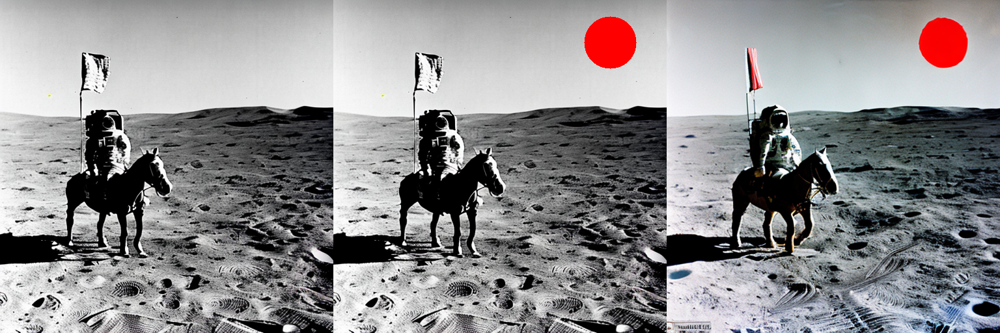

In [43]:
prompt = "High quality photo of an astronaut riding a horse on the moon."
# pass prompt and image to pipeline
image = pipeline(prompt, image=orig_image_edit, strength=0.65).images[0]
make_image_grid([orig_image, orig_image_edit, image], rows=1, cols=3)

  0%|          | 0/35 [00:00<?, ?it/s]

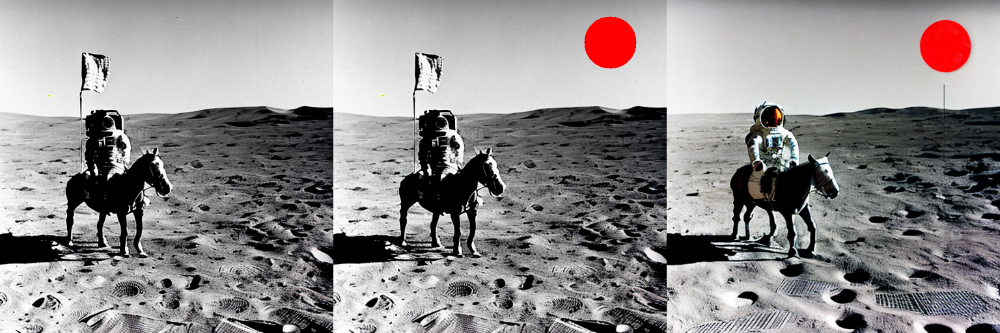

In [46]:
prompt = "High quality photo of an astronaut riding a horse on the moon."
# pass prompt and image to pipeline
image = pipeline(prompt, image=orig_image_edit, strength=0.7).images[0]
make_image_grid([orig_image, orig_image_edit, image], rows=1, cols=3)

  0%|          | 0/37 [00:00<?, ?it/s]

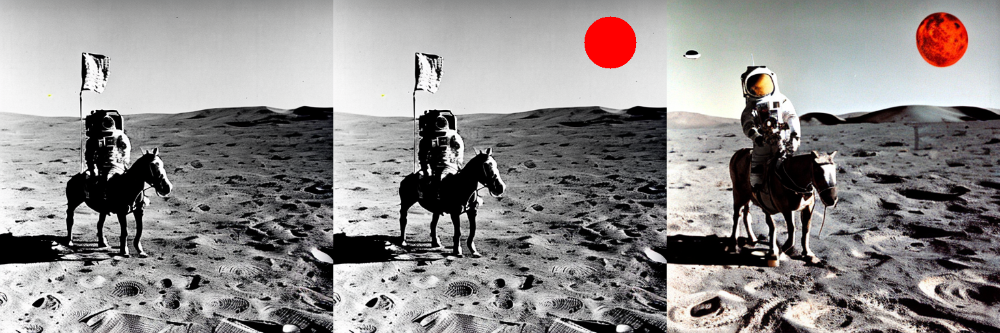

In [50]:
prompt = "High quality photo of an astronaut riding a horse on the moon, with UFO in the background."
# pass prompt and image to pipeline
image = pipeline(prompt, image=orig_image_edit, strength=0.75).images[0]
make_image_grid([orig_image, orig_image_edit, image], rows=1, cols=3)

  0%|          | 0/37 [00:00<?, ?it/s]

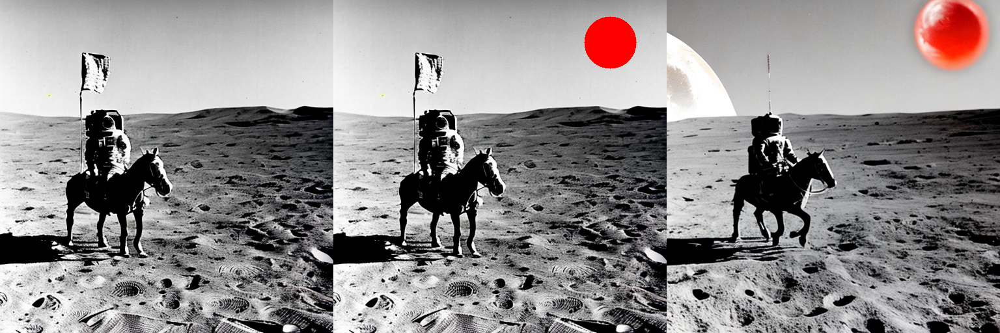

In [54]:
prompt = "High quality photo of an astronaut riding a horse on the moon, with Sauron's eye in the background."
# pass prompt and image to pipeline
image = pipeline(prompt, image=orig_image_edit, strength=0.75).images[0]
make_image_grid([orig_image, orig_image_edit, image], rows=1, cols=3)

  0%|          | 0/37 [00:00<?, ?it/s]

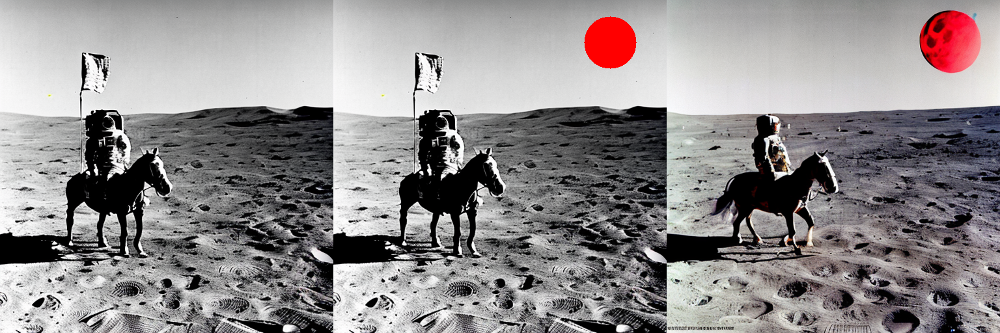

In [47]:
prompt = "High quality photo of an astronaut riding a horse on the moon."
# pass prompt and image to pipeline
image = pipeline(prompt, image=orig_image_edit, strength=0.75).images[0]
make_image_grid([orig_image, orig_image_edit, image], rows=1, cols=3)

  0%|          | 0/35 [00:00<?, ?it/s]

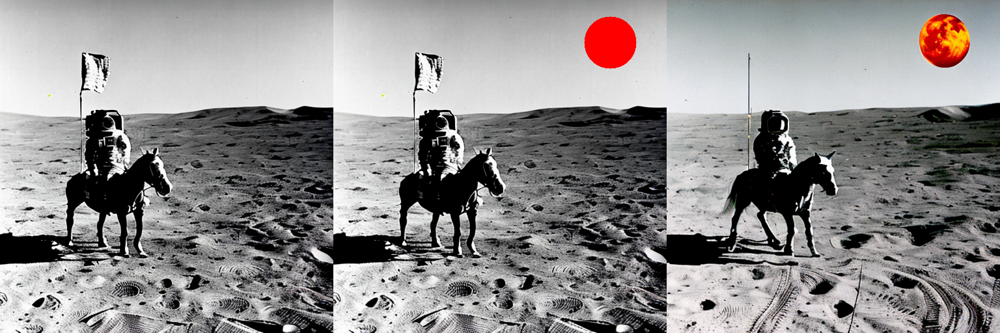

In [38]:
prompt = "High quality photo of an astronaut riding a horse on the moon."
# pass prompt and image to pipeline
image = pipeline(prompt, image=orig_image_edit, strength=.7).images[0]
make_image_grid([orig_image, orig_image_edit, image], rows=1, cols=3)

  0%|          | 0/37 [00:00<?, ?it/s]

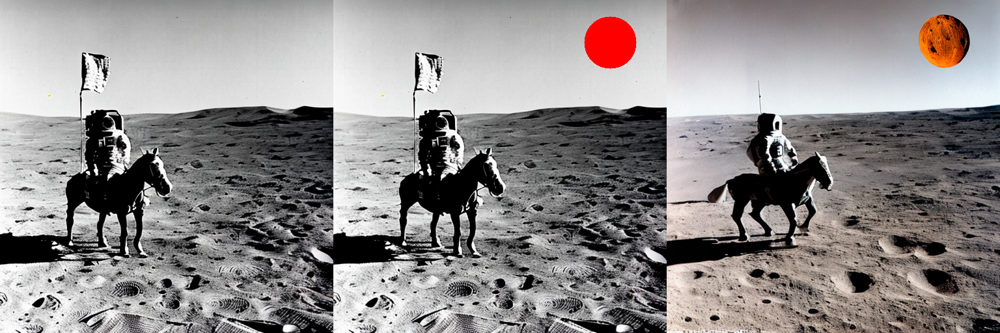

In [35]:
prompt = "High quality photo of an astronaut riding a horse on the moon. with mars in view"
# pass prompt and image to pipeline
image = pipeline(prompt, image=orig_image_edit, strength=0.75).images[0]
make_image_grid([orig_image, orig_image_edit, image], rows=1, cols=3)

### Inpainting Pipeline

In [55]:
from diffusers import StableDiffusionInpaintPipeline

In [56]:
import PIL
import requests
import torch
from io import BytesIO

from diffusers import StableDiffusionInpaintPipeline


def download_image(url):
    response = requests.get(url)
    return PIL.Image.open(BytesIO(response.content)).convert("RGB")


img_url = "https://raw.githubusercontent.com/CompVis/latent-diffusion/main/data/inpainting_examples/overture-creations-5sI6fQgYIuo.png"
mask_url = "https://raw.githubusercontent.com/CompVis/latent-diffusion/main/data/inpainting_examples/overture-creations-5sI6fQgYIuo_mask.png"

init_image = download_image(img_url).resize((512, 512))
mask_image = download_image(mask_url).resize((512, 512))

pipe = StableDiffusionInpaintPipeline.from_pretrained(
    "stabilityai/stable-diffusion-2-base", torch_dtype=torch.float16
)
pipe = pipe.to("cuda")


Fetching 13 files:   0%|          | 0/13 [00:00<?, ?it/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.46G [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.36G [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

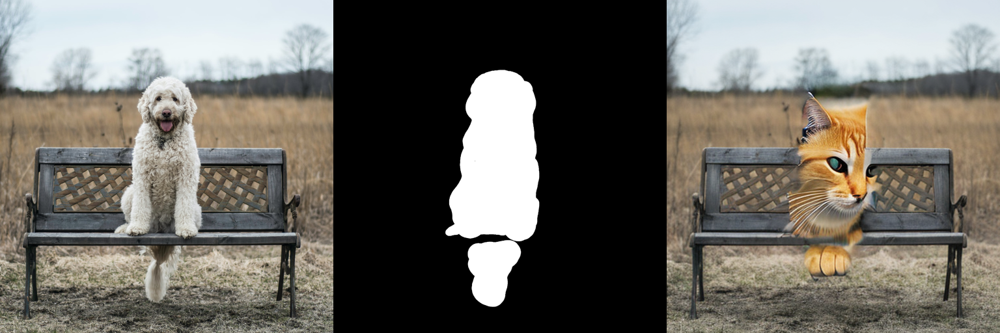

In [61]:
prompt = "Face of a yellow cat, high resolution, sitting on a park bench"
image = pipe(prompt=prompt, image=init_image, mask_image=mask_image).images[0]
make_image_grid([init_image, mask_image, image], rows=1, cols=3)

  0%|          | 0/32 [00:00<?, ?it/s]

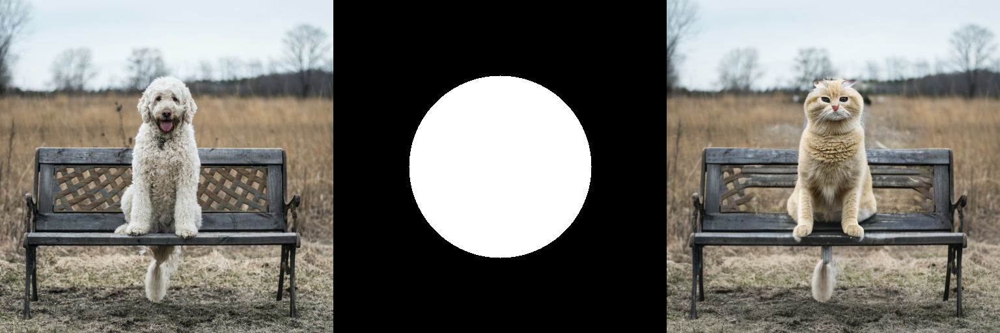

In [71]:
circle_mask = np.zeros((512, 512, 3), dtype=np.uint8)
cv2.circle(circle_mask, (256, 256), 140, (255, 255, 255), thickness=cv2.FILLED, )
circle_mask = Image.fromarray(circle_mask)
prompt = "a pretty yellow cat, high resolution, sitting on a park bench"
image = pipe(prompt=prompt, image=init_image, mask_image=circle_mask, 
             strength=0.65).images[0]
make_image_grid([init_image, circle_mask, image], rows=1, cols=3)

  0%|          | 0/37 [00:00<?, ?it/s]

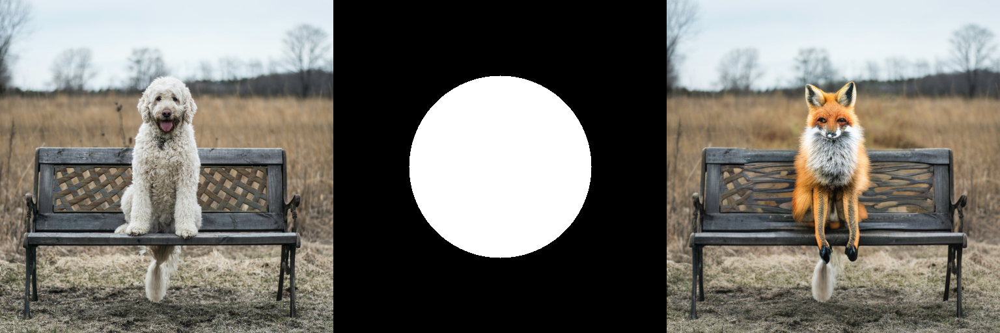

In [74]:
circle_mask = np.zeros((512, 512, 3), dtype=np.uint8)
cv2.circle(circle_mask, (256, 256), 140, (255, 255, 255), thickness=cv2.FILLED, )
circle_mask = Image.fromarray(circle_mask)
prompt = "a pretty fox, high resolution, sitting on a park bench"
image = pipe(prompt=prompt, image=init_image, mask_image=circle_mask, 
             strength=0.75).images[0]
make_image_grid([init_image, circle_mask, image], rows=1, cols=3)

  0%|          | 0/37 [00:00<?, ?it/s]

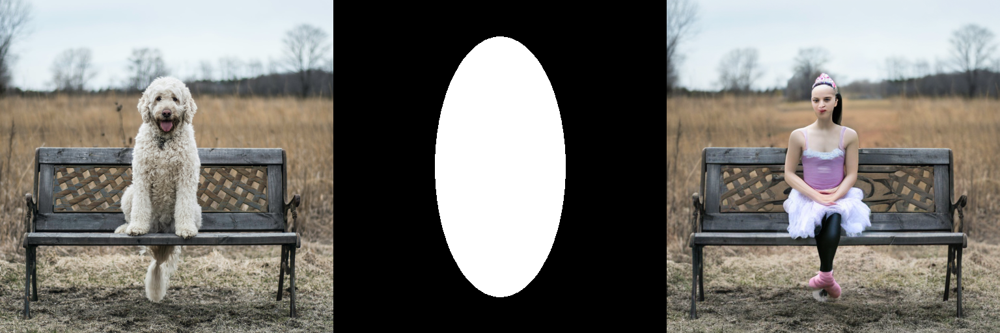

In [79]:
circle_mask = np.zeros((512, 512, 3), dtype=np.uint8)
cv2.ellipse(circle_mask, (256, 256), (100, 200), 0, 0, 360, (255, 255, 255), thickness=cv2.FILLED)
circle_mask = Image.fromarray(circle_mask)
prompt = "a pretty ballerina, high resolution, sitting on a park bench"
image = pipe(prompt=prompt, image=init_image, mask_image=circle_mask, 
             strength=0.75).images[0]
make_image_grid([init_image, circle_mask, image], rows=1, cols=3)

In [23]:
import diffusers
diffusers.__version__

'0.18.2'

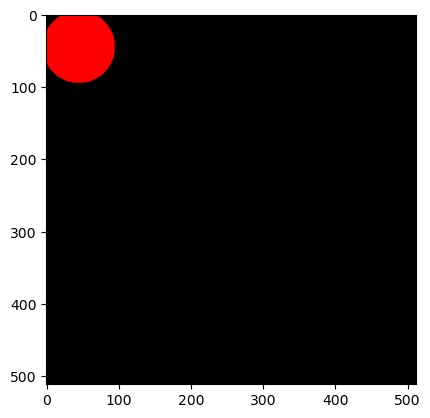